# ABOUT THE DATASET

The dataset under consideration presents a comprehensive repository of detailed records documenting road accidents that transpired in the month of January 2021. This compilation encompasses a wealth of information crucial for dissecting the dynamics of each incident, offering insights into various aspects such as the accident date, day of the week, junction control, accident severity, geographical coordinates, lighting conditions, weather details, and specifics regarding the involved vehicles. The dataset's temporal focus on a single month allows for a more granular examination of the contributing factors to road accidents, offering a snapshot of the urban area's road safety landscape during this specific timeframe.

The significance of this dataset lies in its potential to facilitate in-depth analyses and investigations into the multifaceted causes and consequences of road accidents. By scrutinizing variables such as accident severity and weather conditions, researchers, policymakers, and transportation authorities can gain a nuanced understanding of the challenges and risks present in the urban road network. This knowledge, in turn, can inform the development and implementation of targeted strategies and interventions aimed at enhancing road safety and mitigating the frequency and severity of accidents. Furthermore, the dataset's inclusion of vehicle details and geographical coordinates provides a foundation for spatial analyses, enabling a geographic perspective on accident patterns and hotspots. Altogether, this dataset serves as a valuable resource for those dedicated to unraveling the complexities of road safety, contributing to the ongoing efforts to create safer and more efficient urban roadways.

In [63]:
# Importing important libraries
import os # Interact with operating system files
import pandas as pd # Data manipulation and analysis tool
import numpy as np # Numerical operations and mathematical functions
import seaborn as sns # Statistical data visualization enhancement library
import plotly.express as px # Interactive data visualization with Plotly
import plotly.offline as py # Create offline Plotly charts
import dash # Build interactive web applications
import matplotlib.pyplot as plt # Plotting and data visualization in Python
import matplotlib.animation as animation # Create animated visualizations in Matplotlib
import ipywidgets as widgets # Interactive widgets for Jupyter notebooks

In [72]:
# Define File Path
file_path = r'DEVP-II_Project_Dataset.xlsx'

# Import & Read Dataset
my_df = pd.read_excel('DEVP-II_Project_Dataset.xlsx')

# Display Dataset Information
my_df

,Accident_Index,Accident Date,Day_of_Week,Junction_Control,Junction_Detail,Accident_Severity,Light_Conditions,Carriageway_Hazards,Number_of_Casualties,Number_of_Vehicles,Road_Surface_Conditions,Road_Type,Speed_limit,Time,Urban_or_Rural_Area,Weather_Conditions,Vehicle_Type
0,200901BS70001,2021-01-01,Thursday,Give way or uncontrolled,T or staggered junction,Serious,Daylight,None,1,2,Dry,One way street,30,15:11:00,Urban,Fine no high winds,Car
1,200901BS70002,2021-05-01,Monday,Give way or uncontrolled,Crossroads,Serious,Daylight,None,11,2,Wet or damp,Single carriageway,30,10:59:00,Urban,Fine no high winds,Taxi/Private hire car
2,200901BS70003,2021-04-01,Sunday,Give way or uncontrolled,T or staggered junction,Slight,Daylight,None,1,2,Dry,Single carriageway,30,14:19:00,Urban,Fine no high winds,Taxi/Private hire car
3,200901BS70004,2021-05-01,Monday,Auto traffic signal,T or staggered junction,Serious,Daylight,None,1,2,Frost or ice,Single carriageway,30,08:10:00,Urban,Other,Motorcycle over 500cc
4,200901BS70005,2021-06-01,Tuesday,Auto traffic signal,Crossroads,Serious,Darkness - lights lit,None,1,2,Dry,Single carriageway,30,17:25:00,Urban,Fine no high winds,Car
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
119054,201091NM00057,2022-02-01,Saturday,Data missing or out of range,Not at junction or within 20 metres,Slight,Daylight,None,1,1,Snow,Single carriageway,60,11:25:00,Rural,Fine no high winds,Car
119055,201091NM00102,2022-03-01,Sunday,Give way or uncontrolled,T or staggered junction,Slight,Daylight,None,1,2,Snow,Dual carriageway,60,15:26:00,Rural,Other,Car
119056,201091NM00140,2022-05-01,Tuesday,Data missing or out of range,Not at junction or within 20 metres,Slight,Daylight,None,1,2,Snow,Single carriageway,60,09:28:00,Rural,Snowing no high winds,Car
119057,201091NM00296,2022-08-01,Friday,Data missing or out of range,Not at junction or within 20 metres,Slight,Daylight,None,1,2,Frost or ice,Single carriageway,60,11:00:00,Rural,Fine no high winds,Van / Goods 3.5 tonnes mgw or under


In [66]:
my_df.dtypes # Display the data types of each column in a DataFrame

Accident_Index                     object
Accident Date              datetime64[ns]
Day_of_Week                        object
Junction_Control                   object
Junction_Detail                    object
Accident_Severity                  object
Light_Conditions                   object
Carriageway_Hazards                object
Number_of_Casualties                int64
Number_of_Vehicles                  int64
Road_Surface_Conditions            object
Road_Type                          object
Speed_limit                         int64
Time                               object
Urban_or_Rural_Area                object
Weather_Conditions                 object
Vehicle_Type                       object
dtype: object

In [67]:
# Basic statistics for numerical columns
basic_stats = my_df.describe()

# Display basic statistics
basic_stats.head()

,Number_of_Casualties,Number_of_Vehicles,Speed_limit
count,119059.000000,119059.000000,119059.000000
mean,1.353505,1.829538,38.921711
std,0.798952,0.708581,14.053877
min,1.000000,1.000000,15.000000
25%,1.000000,1.000000,30.000000


In [68]:
# Select relevant columns for correlation analysis
selected_columns = ['Number_of_Casualties' , 'Number_of_Vehicles' , 'Speed_limit']

# Create a subset DataFrame with selected columns
correlation_data = my_df[selected_columns]

# Compute the correlation matrix
correlation_matrix = correlation_data.corr()

correlation_matrix

,Number_of_Casualties,Number_of_Vehicles,Speed_limit
Number_of_Casualties,1.000000,0.234452,0.130659
Number_of_Vehicles,0.234452,1.000000,0.075713
Speed_limit,0.130659,0.075713,1.000000


***Objective 1:*** To visualize the correlations between different attributes within a dataset using an interactive heatmap, identify strong positive or negative relationships between pairs of attributes and to enable exploration of correlation patterns for further analysis and decision-making.

In [69]:
# Create an interactive heatmap using plotly
fig = px.imshow(correlation_matrix,
                labels=dict(x='Attributes', y='Attributes', color='Correlation'),
                x=selected_columns,
                y=selected_columns,
                color_continuous_scale='Viridis')

fig.update_layout(title='Interactive Correlation Heatmap',
                  xaxis=dict(title='Attributes'),
                  yaxis=dict(title='Attributes'))

# Show the plot
fig.show()

***Interpretation & Key Insights:*** 
The strongest correlation observed is between Number of Casualties and Number of Vehicles, suggesting a positive relationship between the number of vehicles involved in an accident and the number of casualties resulting from it. Number of Casualties also shows moderate positive correlations with Speed_limit. Number of Vehicles and Speed_limit have a weaker positive correlation. There are no strong negative correlations (dark blue cells) immediately apparent in the heatmap. The findings suggest that both the number of vehicles involved and the speed limit may play significant roles in accident severity, as measured by the number of casualties.In predictive modeling, it might be possible to reduce feature redundancy by considering only one of the highly correlated attributes (Number of Casualties or Number of Vehicles). Understanding these correlations could inform safety initiatives that focus on: Reducing the number of vehicles involved in accidents (e.g., through traffic management strategies) and Enforcing speed limits in high-risk areas.

In [70]:
# Convert 'Time' column to string
my_df['Time'] = my_df['Time'].astype(str)

# Extract only the daily hour of each accident
my_df['Hour_of_Accident'] = my_df['Time'].str.split(':').str[0]

# Convert 'Hour_of_Accident' column to float
my_df['Hour_of_Accident'] = my_df['Hour_of_Accident'].astype(float)

# Calculate the mean of the 'Hour_of_Accident' column
mean_hour = my_df['Hour_of_Accident'].mean().round(0)

# Fill missing values in the 'Hour_of_Accident' column with the calculated mean
my_df['Hour_of_Accident'].fillna(mean_hour, inplace=True)

# Rename Columns name
my_df = my_df.rename(columns={'Accident_Severity': 'Accident_Injuries', 'Number_of_Casualties': 'death_toll', 'Accident_Index': 'Accident_ID'})

# Creating a Pivot Table to analyze the number of death values based on 'Accident Date' and 'Hour_of_Accident'
pivot_table = pd.pivot_table(my_df, values='death_toll', index=['Accident Date'], columns='Hour_of_Accident', fill_value=None).round(0)
pivot_table

Hour_of_Accident,0.0,1.0,2.0,3.0,4.0,5.0,6.0,7.0,8.0,9.0,...,14.0,15.0,16.0,17.0,18.0,19.0,20.0,21.0,22.0,23.0
Accident Date,,,,,,,,,,,,,,,,,,,,,
2021-01-01,2.0,2.0,1.0,1.0,1.0,1.0,1.0,2.0,1.0,1.0,...,2.0,1.0,2.0,1.0,2.0,1.0,1.0,1.0,2.0,1.0
2021-01-02,1.0,1.0,2.0,2.0,2.0,2.0,NaN,1.0,2.0,1.0,...,1.0,1.0,2.0,1.0,1.0,1.0,1.0,2.0,2.0,1.0
2021-01-03,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,2.0,1.0,2.0,1.0,1.0,2.0,1.0,2.0,1.0,1.0
2021-01-04,1.0,2.0,1.0,2.0,NaN,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0
2021-01-05,2.0,NaN,2.0,3.0,1.0,2.0,2.0,1.0,1.0,2.0,...,1.0,1.0,1.0,1.0,1.0,2.0,1.0,1.0,1.0,2.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-08,1.0,1.0,2.0,1.0,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,1.0,1.0,1.0,1.0,1.0,2.0,2.0,2.0
2022-12-09,1.0,2.0,1.0,1.0,2.0,NaN,1.0,2.0,2.0,1.0,...,1.0,1.0,1.0,2.0,1.0,1.0,1.0,1.0,3.0,2.0
2022-12-10,1.0,2.0,NaN,NaN,1.0,1.0,1.0,1.0,1.0,1.0,...,1.0,1.0,2.0,1.0,1.0,2.0,2.0,1.0,1.0,1.0


# DYNAMIC PLOTS

***Objective 2:*** To visualize the distribution of accidents across urban and rural areas while highlighting the number of casualties involved in each accident, create an animated bar plot that dynamically showcases the changing distribution based on the number of casualties and to enable a visual understanding of how accident patterns and severity differ between urban and rural settings.

In [73]:
import pandas as pd
import plotly.express as px

#  Group the DataFrame my_df by 'Urban_or_Rural_Area' and 'Number_of_Casualties', count the occurrences, and create a new DataFrame
count_data = my_df.groupby(['Urban_or_Rural_Area', 'Number_of_Casualties']).size().reset_index(name='Count')

# Create animated bar plot
Area_distribution_plot = px.bar(
    count_data, 
    x='Urban_or_Rural_Area', 
    y='Count', 
    color='Urban_or_Rural_Area', 
    animation_frame='Number_of_Casualties',
    title='Animated Accidents Distribution by Area'
)

# Set the duration of each animation frame to 100 milliseconds
Area_distribution_plot.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 100

Area_distribution_plot.show()

***Interpretation & Key Insights:*** 
This code creates an interactive animated bar plot that provides a dynamic view of accident distribution across urban and rural areas, highlighting the number of casualties involved in each accident. By animating based on casualty count, it allows us to visually compare and contrast accident patterns and severity between urban and rural settings. We can observe how bar heights change to see if specific casualty levels are more prevalent in one area, or if one area tends to see more severe accidents overall. This visualization can inform targeted safety initiatives and research by revealing potential disparities in accident trends based on location and severity. By playing with the animation and exploring specific casualty ranges, we can gain even deeper insights into these relationships.

***Objective 3:*** To create an interactive chart for exploring the relationship between accident severity, light conditions, and the number of casualties, allow users to filter data based on accident severity and visualize the resulting patterns in a bar chart and to facilitate understanding of how different light conditions might impact accident severity and the number of casualties.

In [74]:
# Import required libraries
from dash import dcc, html
from dash.dependencies import Input, Output

# Initialize the Dash app
app = dash.Dash(__name__)

# Define the app layout
app.layout = html.Div([
    dcc.Dropdown(
        id='Accident_Severity-dropdown',
        options=[
            {'label': acc_severity, 'value': acc_severity} for acc_severity in my_df['Accident_Severity'].unique()
        ],
        value=my_df['Accident_Severity'].unique()[0],  # Default selected value
        style={'width': '50%'}
    ),
    dcc.Graph(id='bar-chart')
])

# Define the callback to update the bar chart based on the selected accident severity
@app.callback(
    Output('bar-chart', 'figure'),
    [Input('Accident_Severity-dropdown', 'value')]
)
def update_chart(selected_acc_severity):
    filtered_df = my_df[my_df['Accident_Severity'] == selected_acc_severity]
    fig = px.bar(filtered_df, x='Light_Conditions', y='Number_of_Casualties', color='Accident_Severity', barmode='group',
                 labels={'Number_of_Casualties': 'Casualties', 'Light_Conditions': 'Light_Conditions'},
                 title=f'Average Number of Casualties by Light Conditions for Accident Severity {selected_acc_severity}')
    return fig

# Run the app
if __name__ == '__main__':
    app.run_server(debug=True, port=8051)

***Interpretation & Key Insights:*** 
This interactive chart empowers us to explore the interplay between accident severity, light conditions, and casualties. By filtering data based on selected accident severity levels, it reveals patterns in the average number of casualties across different light conditions. This dynamic visualization facilitates a deeper understanding of how light conditions might influence accident outcomes, potentially informing targeted safety measures and research initiatives.


***Objective 4:*** To create an animated 3D scatter plot that visualizes the distribution of accidents based on severity and the number of casualties involved, explore how accident frequency and severity relate to casualty counts in a dynamic and interactive way and to enable visual identification of patterns and trends that might not be apparent in static 2D visualizations.

In [75]:
# Group by Severity of accident and number of accidents and calculate the count
count_data = my_df.groupby(['Accident_Severity', 'Number_of_Casualties']).size().reset_index(name='Count')

# Create animated 3D bar plot
Area_distribution_3d_plot = px.scatter_3d(
    count_data, 
    x='Accident_Severity', 
    y='Number_of_Casualties', 
    z='Count',
    color='Accident_Severity',
    animation_frame='Number_of_Casualties',
    title='Animated Accidents Distribution by Severity',
    size_max=20  # Adjust the maximum size of markers as needed
)

# Set the duration of each frame
Area_distribution_3d_plot.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 100

# Show the 3D plot
Area_distribution_3d_plot.show()

***Interpretation & Key Insights:*** 
This code constructs an animated 3D scatter plot, immersing you in a dynamic visual exploration of accident patterns based on severity and casualties. Imagine a 3D space where each point represents an accident, positioned according to its severity on the x-axis, the number of casualties on the y-axis, and the frequency of such accidents (count) reflected in its height on the z-axis. Color-coding distinguishes severity levels, and animation brings the scene to life. As the animation progresses, focusing on different casualty counts, observe how the distribution of points shifts and reshapes. This dynamic perspective can reveal patterns that might be overlooked in static 2D visualizations. These observations can inform targeted prevention strategies and emergency response planning. By understanding how accident severity and casualties intertwine, we can prioritize efforts to mitigate high-risk scenarios and allocate resources more effectively, ultimately striving to reduce accident frequency and severity across the board.

***Objective 5:*** To explore the relationship between road surface conditions and the number of accidents, with a focus on casualty counts, visualize how accident frequency varies across different road surface conditions and casualty levels and to utilize animation to dynamically highlight patterns and trends that might not be evident in static visualizations.

In [76]:
# Group by road surface conditions and number of accidents and calculate the count
count_data = my_df.groupby(['Road_Surface_Conditions', 'Number_of_Casualties']).size().reset_index(name='Count')

# Create animated bar plot
Area_distribution_plot = px.bar(
    count_data, 
    x='Road_Surface_Conditions', 
    y='Count', 
    color='Road_Surface_Conditions', 
    animation_frame='Number_of_Casualties',
    title='Animated Accidents Distribution by Road Surface Conditions'
)

Area_distribution_plot.layout.updatemenus[0].buttons[0].args[1]["frame"]["duration"] = 100

Area_distribution_plot.show()

***Interpretation & Key Insights:*** 
This code visualizes the interplay between road surface conditions and accident frequency, with a dynamic focus on casualty counts. It creates an animated bar chart where each bar represents a specific road surface condition (e.g., dry, wet, icy), and its height reflects the number of accidents that occurred on that surface. Color-coding reinforces visual distinction, and animation unveils patterns across different casualty levels. These observations can inform targeted safety measures, such as:
prioritizing surfaces associated with higher accident rates and casualty levels, focusing on specific risks posed by different surfaces, especially under conditions linked to more severe accidents, exploring materials or designs that might mitigate risks associated with problematic surfaces and by understanding how road surface conditions influence accident frequency and severity, we can create safer driving environments and potentially reduce the number of accidents and casualties.

***Objective 6:*** To create an animated bar chart that visualizes the distribution of accidents across different days of the week for multiple years, dynamically explore how accident patterns vary across years and days of the week, potentially revealing trends and insights and to identify days or periods that are more prone to accidents, informing potential safety measures or awareness campaigns.

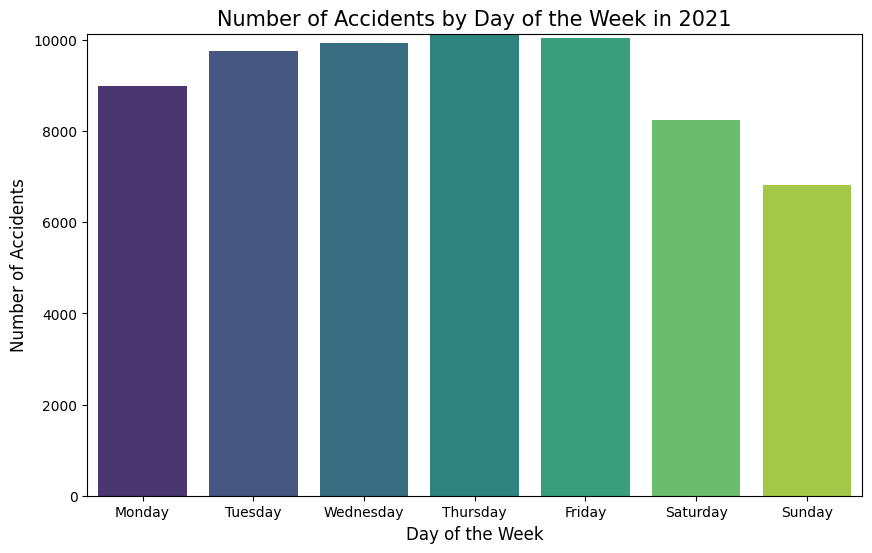

In [77]:
# Import the required python library
from IPython.display import HTML

dataset = pd.read_excel('DEVP-II_Project_Dataset.xlsx')

# Convert 'Accident Date' to datetime and extract the year for filtering
dataset['Accident Date'] = pd.to_datetime(dataset['Accident Date'], format='%d/%m/%y')
dataset['Year'] = dataset['Accident Date'].dt.year

# Filter the data to include only full years for consistent analysis
full_years_data = dataset[dataset['Year'] < 2024]

# Grouping the data by Day of Week and Year
grouped_data = full_years_data.groupby(['Day_of_Week', 'Year']).size().unstack(fill_value=0)

# Sorting the days of the week in the correct order
ordered_days = ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday", "Sunday"]
grouped_data = grouped_data.reindex(ordered_days)

# Preparing the animation
fig, ax = plt.subplots(figsize=(10, 6))

def animate(year):
    ax.clear()
    sns.barplot(x=grouped_data.index, y=grouped_data[year], ax=ax, palette="viridis")
    ax.set_title(f'Number of Accidents by Day of the Week in {year}', fontsize=15)
    ax.set_xlabel('Day of the Week', fontsize=12)
    ax.set_ylabel('Number of Accidents', fontsize=12)
    ax.set_ylim(0, grouped_data.max().max())

# Creating the animation
ani = animation.FuncAnimation(fig, animate, frames=grouped_data.columns, interval=1000)

# Display the animation
HTML(ani.to_jshtml())

***Interpretation & Key Insights:*** 
This code constructs an animated bar chart that brings accident trends to life, visualizing how accident frequency shifts across different days of the week and multiple years. As the animation progresses, it cycles through different years, revealing dynamic patterns and potential insights. These observations can inform: prioritize safety measures and enforcement on days with historically higher accident rates, target messaging and interventions for specific days or periods associated with increased risk delve deeper into factors contributing to day-of-week variations, informing potential policy changes or infrastructure improvements to address recurring patterns and by understanding how accident frequency fluctuates across days and years, we can develop more effective and timely strategies to reduce accidents and enhance road safety.

# STATIC CHARTS 

***Objective 7:*** To analyze accident patterns based on the day of the week, focusing on the number of casualties and the distribution of accidents across different days and to create visualizations that highlight trends and insights, potentially informing safety initiatives or resource allocation.

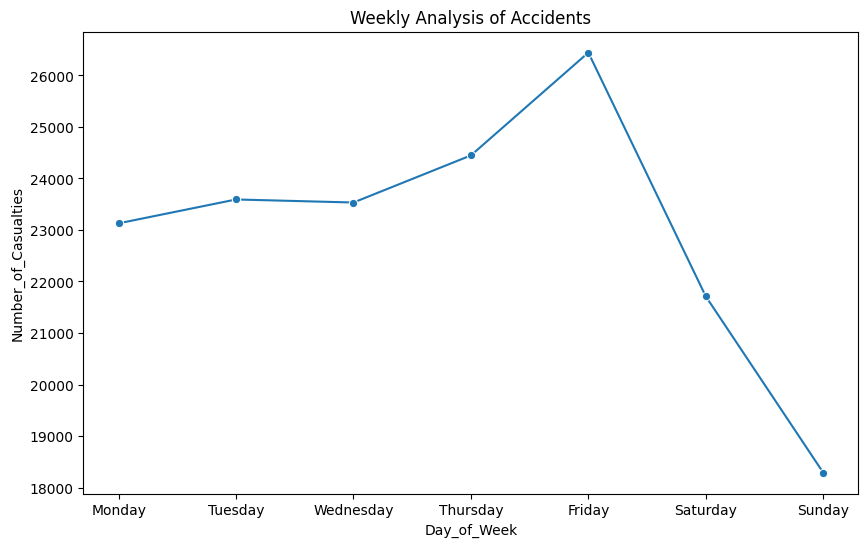

Text(0, 0.5, ' ')

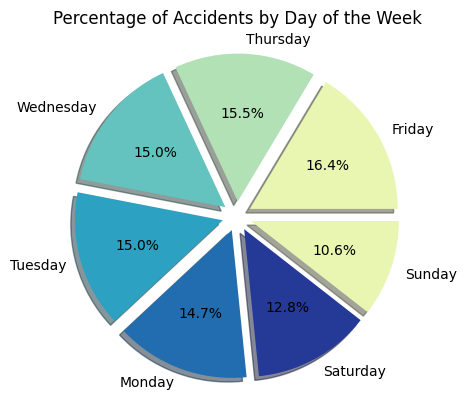

In [78]:
# To ensure the correct order in the plot.
my_df['Day_of_Week'] = pd.Categorical(my_df['Day_of_Week'], categories=['Monday' , 'Tuesday' , 'Wednesday' , 'Thursday' , 'Friday' , 'Saturday' , 'Sunday'], ordered=True)

# Group by weekday and calculate the sum of casualties
weekly_likes = my_df.groupby('Day_of_Week')['Number_of_Casualties'].sum().reset_index()

# Create a line chart for weekly analysis
plt.figure(figsize=(10, 6))
sns.lineplot(x='Day_of_Week', y='Number_of_Casualties', data=weekly_likes, marker='o')
plt.title('Weekly Analysis of Accidents')
plt.xlabel('Day_of_Week')
plt.ylabel('Number_of_Casualties')
plt.show()

# Make a pie chart to display the percentage analysis of accident each day
my_df['Day_of_Week'].value_counts().plot(kind='pie', autopct='%0.1f%%', explode=[0.1, 0.1, 0.1, 0.1, 0.1, 0.1, 0.1], shadow=True, colors=sns.color_palette("YlGnBu"))
plt.title('Percentage of Accidents by Day of the Week')
plt.ylabel(' ')

***Interpretation & Key Insights:*** 
This code explores accident patterns based on the day of the week, focusing on casualty counts and accident distribution. It employs two complementary visualizations: the line chart traces the trend of total casualties across the week, revealing potential peaks and valleys. Look for days associated with consistently higher casualty counts, suggesting increased risk or severity and the pie chart showcases the proportion of accidents occurring on each day, highlighting days with greater accident density. This can inform resource allocation and awareness efforts. Informing Safety Strategies: focus safety measures and enforcement on high-risk days to potentially reduce accidents and casualties, educate drivers about increased risks on specific days, encouraging cautious behavior and proactive measures, distribute resources and personnel strategically to address day-of-week variations in accident patterns and by understanding how accidents and casualties align with different days of the week, we can make informed decisions to enhance safety and potentially save lives.

***Objective 8:*** To explore the relationship between speed limits, accident casualties, and urban/rural areas using two complementary visualizations and to uncover patterns and insights that could inform safety measures and policy decisions.

In [79]:
my_df['Accident Date'] = pd.to_datetime(my_df['Accident Date']).dt.strftime('%Y-%m-%d')  # Convert to string

# Scatter plot for Number of Casualties vs Speed Limit
scatter_fig = px.scatter(my_df, x="Speed_limit", y="Number_of_Casualties", color="Urban_or_Rural_Area",
                         title="Number of Casualties vs Speed Limit",
                         labels={"Number_of_Casualties": "No. of Casualties", "Speed_limit": "Speed Limit"},
                         hover_name="Road_Surface_Conditions")

scatter_fig.update_layout(
    xaxis_title="Speed Limit",
    yaxis_title="Number of Casualties",
)

# Box plot for Speed Limit distribution in Urban and Rural areas
box_fig = px.box(my_df, x="Urban_or_Rural_Area", y="Speed_limit", color="Urban_or_Rural_Area",
                 title="Speed Limit Distribution in Urban and Rural Areas",
                 labels={"Speed_limit": "Speed Limit", "Urban_or_Rural_Area": "Urban or Rural"})

box_fig.update_layout(
    xaxis_title="Urban or Rural Area",
    yaxis_title="Speed Limit",
)

# Display both figures
scatter_fig.show()
box_fig.show()

***Interpretation & Key Insights:*** 
This code unravels the interplay between speed limits, accident casualties, and urban/rural areas using two distinct visualizations: Scatter plot which uUncovers patterns between speed limits and casualties and the Box plot compares speed limit distributions in urban and rural areas. Combine insights from both visualizations to inform: Focus on areas or conditions where high speed limits and casualties coincide, Reassess speed limits in areas with high casualty rates or significant speed variability, Consider traffic calming measures or speed-reducing infrastructure in high-risk zones, Educate drivers about speed-related risks in different areas and conditions and by understanding these relationships, we can make informed decisions to reduce accidents, minimize casualties, and promote safer roads for everyone.

***Objective 9:*** To visualize the relationship between accident severity and the average speed limit at which accidents occur and to explore whether there are trends or patterns that suggest a connection between these two factors.

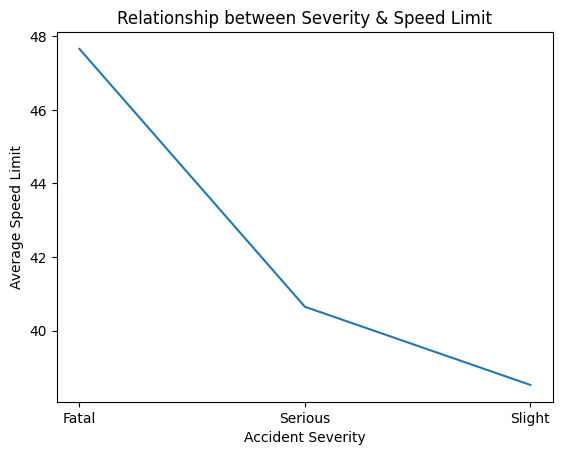

In [80]:
#  Initializes a new Matplotlib figure
fig_energy_valence = plt.figure()

aggregated_df = my_df.groupby('Accident_Severity')['Speed_limit'].mean().reset_index()

# Uses Seaborn to create a line plot (lineplot). The x-axis represents 'Accident_Severity', the y-axis represents the average speed limit, and the data is provided by the aggregated_df
sns.lineplot(x='Accident_Severity', y='Speed_limit', data=aggregated_df)

# Set the label for the axes
plt.xlabel('Accident Severity')
plt.ylabel('Average Speed Limit')
plt.title('Relationship between Severity & Speed Limit')
plt.show()

***Interpretation & Key Insights:*** 
This code visualizes the relationship between accident severity and average speed limits using a line plot. It explores whether trends suggest a connection that could inform safety initiatives. The code groups accident data by severity level and calculates the average speed limit for each level and Seaborn generates a line plot, where the x-axis represents severity levels and the y-axis displays average speed limits. 

***Objective 10:*** To create a hexbin plot that visualizes the relationships between vehicle type, number of casualties, and day of the week in road accidents and to explore patterns and potential correlations between these factors to inform safety initiatives and research.

In [81]:
my_df['Accident Date'] = pd.to_datetime(my_df['Accident Date']).dt.strftime('%Y-%m-%d')  # Convert to string

# Hexbin-like scatter plot for Vehicle type, number of casualties, and day of the week
hexbin_fig = px.scatter(my_df, x="Day_of_Week", y="Number_of_Casualties", color="Vehicle_Type",
                        marginal_x="histogram", marginal_y="histogram", title="Hexbin Plot for Vehicle Type, Number of Casualties, and Day of the Week",
                        labels={"Number_of_Casualties": "No. of Casualties", "Day_of_Week": "Day of the Week"},
                        category_orders={"Day_of_Week": ["Monday", "Tuesday", "Wednesday", "Thursday", "Friday", "Saturday" , "Sunday"]})

hexbin_fig.update_layout(
    xaxis_title="Day of the Week",
    yaxis_title="Number of Casualties",
)

# Display the hexbin-like plot
hexbin_fig.show()

***Interpretation & Key Insights:*** 
The hexbin plot aims to uncover patterns between vehicle types, accident casualties, and days of the week.Each hexagon represents an accident, its color indicating the vehicle type involved. Denser clusters of hexagons suggest a higher frequency of accidents for those vehicle types on those days and casualty levels. Areas with few hexagons indicate lower accident rates for those vehicle types under those conditions. The histograms along the axes reveal the overall distribution of accidents across days of the week and casualty counts. Identify high-risk combinations of vehicle types, days of the week, and casualty levels, potentially leading to targeted interventions. Uncover potential correlations between vehicle types and accident severity, informing safety regulations or design improvements. Inform targeted safety campaigns or enforcement efforts for specific vehicle types or days of the week. Guide research into factors contributing to accident patterns, such as driver behavior, vehicle characteristics, or road conditions.

***Objective 11:*** To explore the distribution of accidents across different vehicle types and light conditions, using side-by-side visualizations for comparison and to uncover potential patterns or relationships that could inform safety measures or research directions.

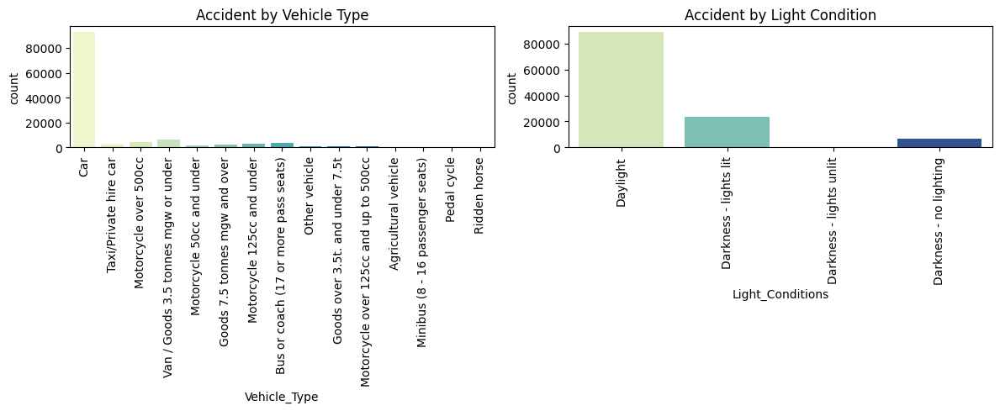

In [82]:
plt.figure(figsize=(12, 5))

# First subplot: Accident by vehicle type
plt.subplot(1, 2, 1)
sns.countplot(data=my_df, x="Vehicle_Type", palette="YlGnBu")
plt.title('Accident by Vehicle Type')
plt.xticks(rotation=90)

# Second subplot: Accident by light condition
plt.subplot(1, 2, 2)
sns.countplot(data=my_df, x="Light_Conditions", palette="YlGnBu")
plt.title('Accident by Light Condition')
plt.xticks(rotation=90)

# Adjust layout to prevent overlapping
plt.tight_layout()

***Interpretation & Key Insights:*** 
Two Side-by-Side Countplots: Left Plot visualizes accident frequency for different vehicle types and Right Plot visualizes accident frequency under various light conditions using "YlGnBu" for visual clarity and consistency and rotated X-Ticks: Ensures readability of labels, especially for longer categories.The viewer can look for vehicle types with notably higher accident counts in the left plot, examine the right plot to visualize how accident frequency varies across different light conditions and consider whether any patterns emerge between specific vehicle types and light conditions, suggesting potential relationships. Potential Insights and Implications: Focus safety campaigns, enforcement, or infrastructure improvements on high-risk vehicle types or light conditions, Inform potential changes to vehicle design or safety regulations based on accident patterns related to vehicle types, Improve lighting or visibility in areas or conditions with higher accident rates linked to light levels and Drive research into factors contributing to observed patterns, such as driver behavior, vehicle characteristics, or road design.

***Objective 12:*** To visualize the average number of casualties in road accidents for different weather conditions and to explore whether certain weather conditions are associated with more severe accidents, potentially informing safety measures or weather-related driving advisories.

In [83]:
# Calculate average number of casualties per weather condition
average_casualties = my_df.groupby('Weather_Conditions')['Number_of_Casualties'].mean().reset_index()

# Plot the data using Plotly Express
fig = px.bar(average_casualties, x='Weather_Conditions', y='Number_of_Casualties',
             title='Average Number of Casualties by Weather Conditions',
             labels={'Weather_Conditions': 'Weather Conditions', 'Number_of_Casualties': 'Average Number of Casualties'})

fig.show()

***Interpretation & Key Insights:*** 
The bar chart aims to visualize the average number of casualties in road accidents for different weather conditions. It explores whether certain weather conditions are associated with more severe accidents, potentially informing safety measures or advisories. The code first calculates the average number of casualties for each distinct weather condition. Plotly Express generates a bar chart where: X-axis represents different weather conditions and Y-axis displays the average number of casualties for each condition. The chart can help in identify high-risk conditions by determining which weather conditions have the highest average casualty counts, suggesting increased risk and also to uncover patterns by examining the chart for patterns or groupings among weather conditions with similar casualty levels.

***Objective 13:*** To visualize the daily distribution of accidents to identify patterns or trends in accident frequency over time and to uncover potential high-risk days or periods that might warrant further investigation or safety interventions.

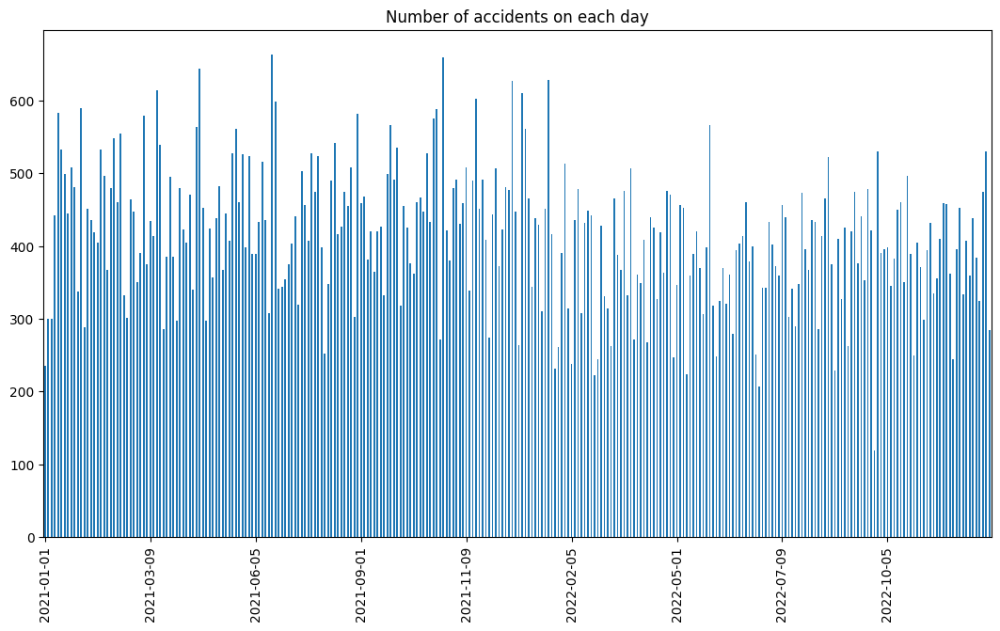

In [84]:
# Initializes a new Matplotlib figure a specified size of 13 inches by 7 inches
plt.figure(figsize=(13,7))

my_df['Date'] = pd.to_datetime(my_df['Accident Date']).dt.date
my_df = my_df.sort_values(by=['Date'])

# Counts the occurrences of each unique date in the 'Date' column, then plots a bar chart
my_df['Date'].value_counts()[my_df['Date'].unique()].plot(kind='bar')

# Sets the x-axis locator parameters to display a maximum of 9 ticks (dates) for better readability
plt.locator_params(axis='x', nbins=9)
plt.title('Number of accidents on each day')
plt.show()

***Interpretation & Key Insights:*** 
The code visualizes the daily distribution of accidents using a bar chart, aiming to identify patterns, trends, and high-risk periods. It prepares the data by converting "Accident Date" to a date format and sorting by date. It then counts accidents for each unique date and plots the results as bars for visual analysis. Key insights to be gleaned from the plot include identifying high-risk days with the most accidents, examining overall trends (e.g., increasing, decreasing, fluctuating) or seasonality, and detecting specific patterns related to days of the week, months, or seasons. Outliers with exceptionally high or low accident counts also warrant investigation to understand potential contributing factors. These insights can inform targeted safety measures, resource allocation, further research into factors influencing accident patterns, and public awareness campaigns about high-risk periods.

***Objective 14:*** To create a count plot that visualizes the distribution of accidents across different vehicle types and to identify vehicle types most frequently involved in accidents, potentially informing safety initiatives or research directions.

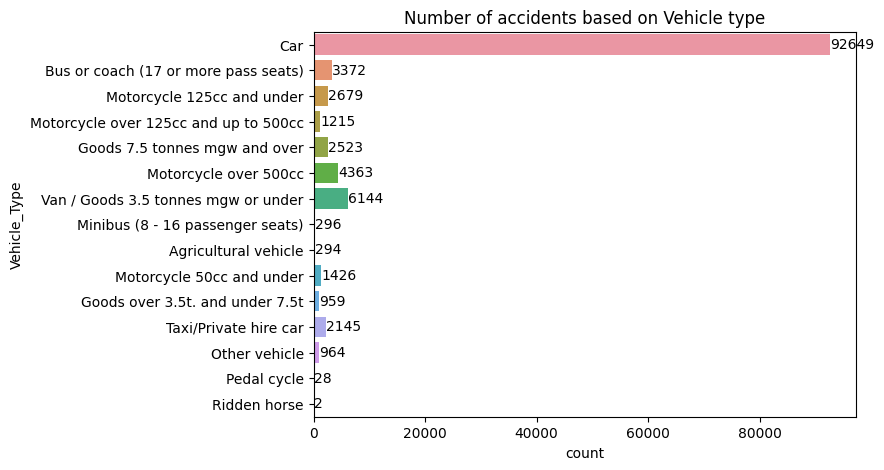

In [85]:
# Initialize a new Matplotlib figure with a specified size of 7 inches by 5 inches
plt.figure(figsize=(7,5))
ax = sns.countplot(data = my_df, y='Vehicle_Type')

# Add labels on top of each bar indicating the count of accidents for the corresponding vehicle type
for container in ax.containers:
    ax.bar_label(container)
    
# Set the title of the plot as 'Number of accidents based on Vehicle type'    
plt.title('Number of accidents based on Vehicle type')
plt.show()

***Interpretation & Key Insights:*** 
The code generates a count plot to visualize accident distribution across different vehicle types. It aims to identify those most frequently involved in accidents, potentially informing safety initiatives or research. Cars are clearly the vehicle type involved in the most accidents. Ridden horses have the lowest accident count, potentially highlighting their limited presence on roads. This underscores the importance of considering different vehicle types and their specific safety needs.The significant disparity between cars and other vehicle types indicates the need for differentiated safety approaches. Tailoring safety measures to address the unique risks and contexts of various vehicles is crucial. Targeted Safety Measures for Cars: Implement campaigns, regulations, or infrastructure improvements specifically aimed at addressing common car-related accident causes, such as speeding, distracted driving, or adverse weather conditions.

***Objective 15:*** To visualize the distribution of accidents across different months of the year to identify potential patterns or trends in accident frequency, uncover high-risk months or seasonal variations that might warrant further investigation or targeted safety interventions and to guide resource allocation and safety initiatives based on monthly accident patterns.

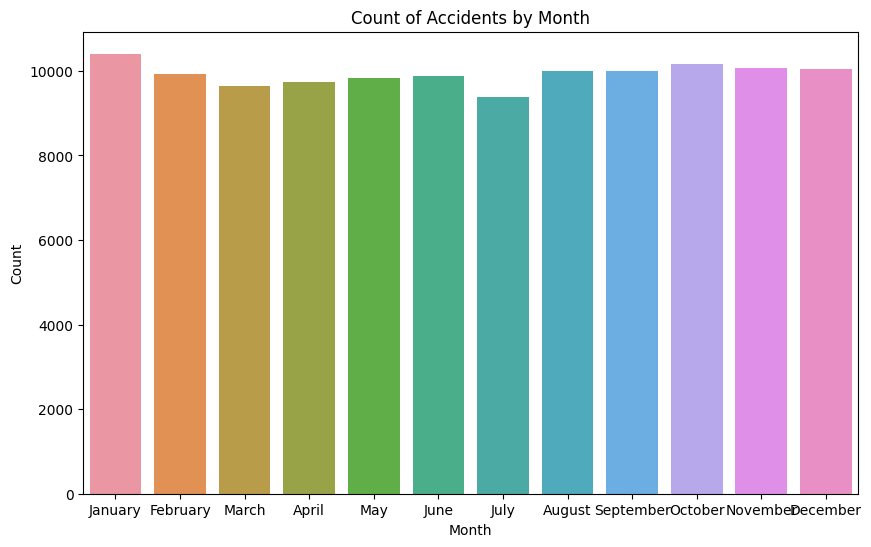

In [86]:
# Read data from an Excel file and loads it into a DataFrame
data=pd.read_excel('DEVP-II_Project_Dataset.xlsx')

data['Accident Date'] = pd.to_datetime(data['Accident Date'], format='%m/%d/%Y')

# Extract the month names from the 'Accident Date' and creates a new column named 'Month'
data['Month'] = data['Accident Date'].dt.month_name()

plt.figure(figsize=(10, 6))

#  Uses Seaborn's "countplot" to create a bar plot. The x-axis represents the months, and the y-axis represents the count of accidents. The order of the months is explicitly specified for proper ordering
sns.countplot(x='Month', data=data, order=['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 'October', 'November', 'December'])
plt.title('Count of Accidents by Month')
plt.xlabel('Month')
plt.ylabel('Count')
plt.show()

***Interpretation & Key Insights:*** 
The code visualizes the monthly distribution of accidents using a count plot to identify patterns, trends, and high-risk periods. It aims to inform resource allocation and safety initiatives.

# PREDICT MODEL

***Objective 16:*** To create a machine learning model that can predict the severity of road accidents based on various factors, potentially aiding in accident prevention and response efforts and to evaluate the model's performance using accuracy and a classification report to assess its potential usefulness in real-world applications.

In [87]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report
from sklearn.preprocessing import LabelEncoder
from sklearn.utils.class_weight import compute_class_weight

# Convert 'Accident_Severity' to numerical labels
label_encoder = LabelEncoder()
data['Accident_Severity'] = label_encoder.fit_transform(data['Accident_Severity'])

# Feature engineering: Extract month and day from 'Accident Date'
data['Accident Date'] = pd.to_datetime(data['Accident Date'], format='%m/%d/%Y')
data['Month'] = data['Accident Date'].dt.month
data['Day'] = data['Accident Date'].dt.day

# Select features and target variable
X = data[['Day_of_Week', 'Junction_Control', 'Junction_Detail', 'Light_Conditions', 'Month', 'Day']]
y = data['Accident_Severity']

# Convert categorical features to numerical using one-hot encoding
X = pd.get_dummies(X)

# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Get unique classes from y_train
unique_classes = sorted(y_train.unique())

# Calculate class weights to handle imbalanced classes
class_weights = compute_class_weight('balanced', classes=unique_classes, y=y_train)
class_weight_dict = {i: w for i, w in zip(unique_classes, class_weights)}

# Create a random forest classifier with class weights
model = RandomForestClassifier(class_weight=class_weight_dict, random_state=42)

# Train the model
model.fit(X_train, y_train)

# Make predictions on the test set
y_pred = model.predict(X_test)

# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.2f}')

# Display classification report
print('Classification Report:')
print(classification_report(y_test, y_pred))

Accuracy: 0.51
Classification Report:
              precision    recall  f1-score   support

           0       0.02      0.25      0.03       321
           1       0.15      0.31      0.20      3161
           2       0.87      0.55      0.67     20330

    accuracy                           0.51     23812
   macro avg       0.34      0.37      0.30     23812
weighted avg       0.76      0.51      0.60     23812



***Interpretation & Key Insights:*** 
Precision is 51%. The model's overall performance is modest, with room for improvement. Precision and recall are particularly low for classes 0 and 1, suggesting difficulty in predicting these severities accurately. Class imbalance likely contributes to the challenges. The current model's potential for real-world use is limited due to its accuracy. Significant improvements would be necessary before deployment in safety-critical applications. It could, however, serve as a starting point for further exploration and refinement.

# ADDITIONAL PLOTS MADE WITH DROPDOWN

*Tried making and editing the code again and again for this plot but with over the time, I will practice and find the error

***Objective 17:*** 
The code creates an interactive bubble chart that visualizes the relationship between road types, days of the week, and the number of casualties in road accidents. It allows users to dynamically filter the data based on selected carriageway hazards, enabling focused exploration of specific accident scenarios.

In [88]:
import pandas as pd
import plotly.express as px
import ipywidgets as widgets
from IPython.display import display

data = pd.DataFrame({
    'Day_of_Week': ['Monday', 'Tuesday', 'Wednesday'],
    'Time': ['10:00', '16:00', '18:00'],
    'Accident_Severity': ['Slight', 'Serious', 'Fatal'],
    'Number_of_Casualties': [21, 24, 26],
    'Road_Type': ['Dual carriageway', 'Single carriageway', 'Roundabout'],
    'Carriageway_Hazards': ['None', 'Oil or diesel', 'Other object on road']
})

# Create a checklist for Carriageway_Hazards
hazards_checklist = widgets.SelectMultiple(
    options=data['Carriageway_Hazards'].unique(),
    value=tuple(data['Carriageway_Hazards'].unique()),  # Convert to tuple
    description='Carriageway Hazards',
    disabled=False
)

# Create an "Update Chart" button
update_button = widgets.Button(description="Update Chart")

# Output widget for displaying the chart
output_chart = widgets.Output()

# Function to update the bubble chart based on the selected hazards
def update_chart(button):
    with output_chart:
        output_chart.clear_output()

        selected_hazards = hazards_checklist.value
        filtered_data = data[data['Carriageway_Hazards'].isin(selected_hazards)]

        # Assuming 'Time' column contains time in HH:MM format
        filtered_data['Time'] = pd.to_datetime(filtered_data['Time'], format='%H:%M').dt.time

        figure = px.scatter(filtered_data,
                            x='Road_Type',
                            y='Day_of_Week',
                            size='Number_of_Casualties',
                            color='Road_Type',
                            title='Number of Casualties by Road Type Over Time',
                            labels={'Road_Type': 'Road Type', 'Day_of_Week': 'Day of Week'},
                            size_max=60)
        figure.show()

# Attach the update_chart function to the button's on_click event
update_button.on_click(update_chart)

# Display the checklist, button, and chart output
display(hazards_checklist)
display(update_button)
display(output_chart)

SelectMultiple(description='Carriageway Hazards', index=(0, 1, 2), options=('None', 'Oil or diesel', 'Other ob…

Button(description='Update Chart', style=ButtonStyle())

Output()

# BAR CHART RACE

***Objective 18:*** 
The code creates an animated bar chart race, a compelling way to visualize how values evolve over time or across different categories and this approach would effectively captures trends, shifts in rankings, and patterns that might be overlooked in static visualizations.

In [89]:
# Create a pivot table
pivot_table = pd.pivot_table(my_df, values='Accident Date', index='Day_of_Week', aggfunc='count')

# Display the pivot table
print(pivot_table)

             Accident Date
Day_of_Week               
Monday               17448
Tuesday              17836
Wednesday            17906
Thursday             18462
Friday               19546
Saturday             15291
Sunday               12570


In [90]:
import pandas as pd

# Convert 'Accident Date' to datetime format with errors='coerce'
my_df['Accident Date'] = pd.to_datetime(my_df['Accident Date'], errors='coerce')

# Drop rows with NaT values in 'Accident Date'
my_df = my_df.dropna(subset=['Accident Date'])

# Extract month from 'Accident Date'
my_df['Month'] = my_df['Accident Date'].dt.month_name()

# Create a pivot table with 'Month' and 'Day_of_Week'
pivot_table = pd.pivot_table(my_df, values='Accident Date', index=['Month', 'Day_of_Week'], aggfunc='count').unstack()

# Display the pivot table
print(pivot_table)

            Accident Date                                                  
Day_of_Week        Monday Tuesday Wednesday Thursday Friday Saturday Sunday
Month                                                                      
April                1134     845      1865     1709   1541     1419   1221
August               1761    1473      1706     1736   1298      842   1189
December             1702    1163       831     1913   1886     1288   1257
February             1656    1880      1471     1570   1631     1115    606
January              2123    1536      1623     1612   1476      789   1247
July                 1334    1705      1588     1132    890     1565   1172
June                 1720    1906      1097      797   1924     1507    929
March                 638    1748      1657     1440   1775     1449    928
May                  1626    1185       805     1654   1959     1257   1349
November             1189     854      1928     1725   1544     1583   1245
October     

In [91]:
import pandas as pd

# Assuming you have already read the CSV file into a DataFrame named 'df'

# Convert 'Accident Date' to datetime format with errors='coerce'
my_df['Accident Date'] = pd.to_datetime(my_df['Accident Date'], errors='coerce')

# Drop rows with NaT values in 'Accident Date'
my_df = my_df.dropna(subset=['Accident Date'])

# Extract month from 'Accident Date'
my_df['Month'] = my_df['Accident Date'].dt.month_name()

# Create a pivot table with 'Month' and 'Day_of_Week'
pivot_table = pd.pivot_table(my_df, values='Accident Date', index=['Month', 'Day_of_Week'], aggfunc='count').unstack()

# Remove the level name from the columns
pivot_table.columns = pivot_table.columns.droplevel()

# Display the pivot table
print(pivot_table)

Day_of_Week  Monday  Tuesday  Wednesday  Thursday  Friday  Saturday  Sunday
Month                                                                      
April          1134      845       1865      1709    1541      1419    1221
August         1761     1473       1706      1736    1298       842    1189
December       1702     1163        831      1913    1886      1288    1257
February       1656     1880       1471      1570    1631      1115     606
January        2123     1536       1623      1612    1476       789    1247
July           1334     1705       1588      1132     890      1565    1172
June           1720     1906       1097       797    1924      1507     929
March           638     1748       1657      1440    1775      1449     928
May            1626     1185        805      1654    1959      1257    1349
November       1189      854       1928      1725    1544      1583    1245
October         847     1905       1880      1463    1695      1530     832
September   

In [92]:
import pandas as pd
import bar_chart_race as bcr


# Adjust the figure size to indirectly control bar width
fig_size = (6, 3)  # You can adjust the values based on your preference

# Create the race chart with improved settings
bcr.bar_chart_race(my_df=pivot_table, title="Day vs Month", figsize=fig_size, period_length=1, period_label={'x': 0.99, 'y': 0.12, 'ha': 'right'},
                    steps_per_period=500, interpolate_period=False, bar_kwargs={'alpha': 0.5})

TypeError: bar_chart_race() got an unexpected keyword argument 'my_df'

**SOURCES**
1. https://www.kaggle.com/ (Kaggle) For Dataset- Car Accidents in 2021 and 2022
2. https://chat.openai.com/ (ChatGpt) for Code Correction & Assistance
3. GitHub for Inspiration from the Analysts and Coders